In [12]:
import networkx as nx
import pandas as pd

df1 = pd.read_csv("after-concepts-pmi_finale.csv", encoding='latin1')

In [13]:
df2 = pd.read_csv("after-concepts.csv")

In [19]:
df1 = df1.rename(columns={'Titre': 'Title'})


In [23]:
df2 = df2.rename(columns={'Figures': 'References'})

In [24]:
df = pd.concat([df1, df2], axis=0)

In [26]:
df = df.reset_index(drop=True)

In [27]:
df

,Number,Title,Description,Described In,References,Definition,kw_bert,synonyms,SynonymsKW,Summary,Subject,Relation,Object,sentence
0,1.2,Project Risk Management Definition,"the definition of project risk management;, a...",NaN,PMIimgs/figureNone.png,"the definition of project risk management, as ...","['project risk management', 'definition projec...","['project risk management', 'standard project ...",[-5.38134202e-03 3.57515156e-01 1.51973441e-...,the pmboke guide fourth edition defines projec...,basis practice standard project risk management,include,process,NaN
1,1.2,Project Risk Management Definition,"the definition of project risk management;, a...",NaN,PMIimgs/figureNone.png,"the definition of project risk management, as ...","['project risk management', 'definition projec...","['project risk management', 'standard project ...",[-5.38134202e-03 3.57515156e-01 1.51973441e-...,the pmboke guide fourth edition defines projec...,control project,pmboke,guide fourth edition state objective,NaN
2,1.2,Project Risk Management Definition,"the definition of project risk management;, a...",NaN,PMIimgs/figureNone.png,"the definition of project risk management, as ...","['project risk management', 'definition projec...","['project risk management', 'standard project ...",[-5.38134202e-03 3.57515156e-01 1.51973441e-...,the pmboke guide fourth edition defines projec...,risk management,be,increase probability,NaN
3,1.2,Project Risk Management Definition,"the definition of project risk management;, a...",NaN,PMIimgs/figureNone.png,"the definition of project risk management, as ...","['project risk management', 'definition projec...","['project risk management', 'standard project ...",[-5.38134202e-03 3.57515156e-01 1.51973441e-...,the pmboke guide fourth edition defines projec...,negative event project,pmboke,guide fourth edition project risk,NaN
4,1.2,Project Risk Management Definition,"the definition of project risk management;, a...",NaN,PMIimgs/figureNone.png,"the definition of project risk management, as ...","['project risk management', 'definition projec...","['project risk management', 'standard project ...",[-5.38134202e-03 3.57515156e-01 1.51973441e-...,the pmboke guide fourth edition defines projec...,project,objective include,scope,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2107,11.7.3.4,PROJECT DOCUMENTS UPDATES,project document that may be update as a resul...,"4.1.3.2, 4.3.3.3, 4.4.3.1, 11.2.3.1, 11.2.3.2",PMBOOKimgs/figureNone.png,project document that may be update as a resul...,"['projects risk register', 'risk process inclu...",NaN,[-5.02593592e-02 3.71453166e-01 3.46995533e-...,NaN,s0 forth.risk report,..,new information become,['project document that may be update as a res...
2108,11.7.3.4,PROJECT DOCUMENTS UPDATES,project document that may be update as a resul...,"4.1.3.2, 4.3.3.3, 4.4.3.1, 11.2.3.1, 11.2.3.2",PMBOOKimgs/figureNone.png,project document that may be update as a resul...,"['projects risk register', 'risk process inclu...",NaN,[-5.02593592e-02 3.71453166e-01 3.46995533e-...,NaN,available monitor risksprocess risk report,be,update reflect current status,['project document that may be update as a res...
2109,11.7.3.4,PROJECT DOCUMENTS UPDATES,project document that may be update as a resul...,"4.1.3.2, 4.3.3.3, 4.4.3.1, 11.2.3.1, 11.2.3.2",PMBOOKimgs/figureNone.png,project document that may be update as a resul...,"['projects risk register', 'risk process inclu...",NaN,[-5.02593592e-02 3.71453166e-01 3.46995533e-...,NaN,major individual project risk,currentlevel,overall project risk risk report,['project document that may be update as a res...
2110,11.7.3.4,PROJECT DOCUMENTS UPDATES,project document that may be update as a resul...,"4.1.3.2, 4.3.3.3, 4.4.3.1, 11.2.3.1, 11.2.3.2",PMBOOKimgs/figureNone.png,project document that may be update as a resul...,"['projects risk register', 'risk process inclu...",NaN,[-5.02593592e-02 3.71453166e-01 3.46995533e-...,NaN,it,may include,conclusion ri

In [106]:
df = df.head(200)

In [99]:
df=pd.read_csv('final9999.csv')

In [29]:
import torch


# Entire graph (DGL and nx representation )

C:\Users\eyawo\anaconda3\lib\site-packages\dgl\heterograph.py:92: DGLWarning: Recommend creating graphs by `dgl.graph(data)` instead of `dgl.DGLGraph(data)`.
  dgl_warning(


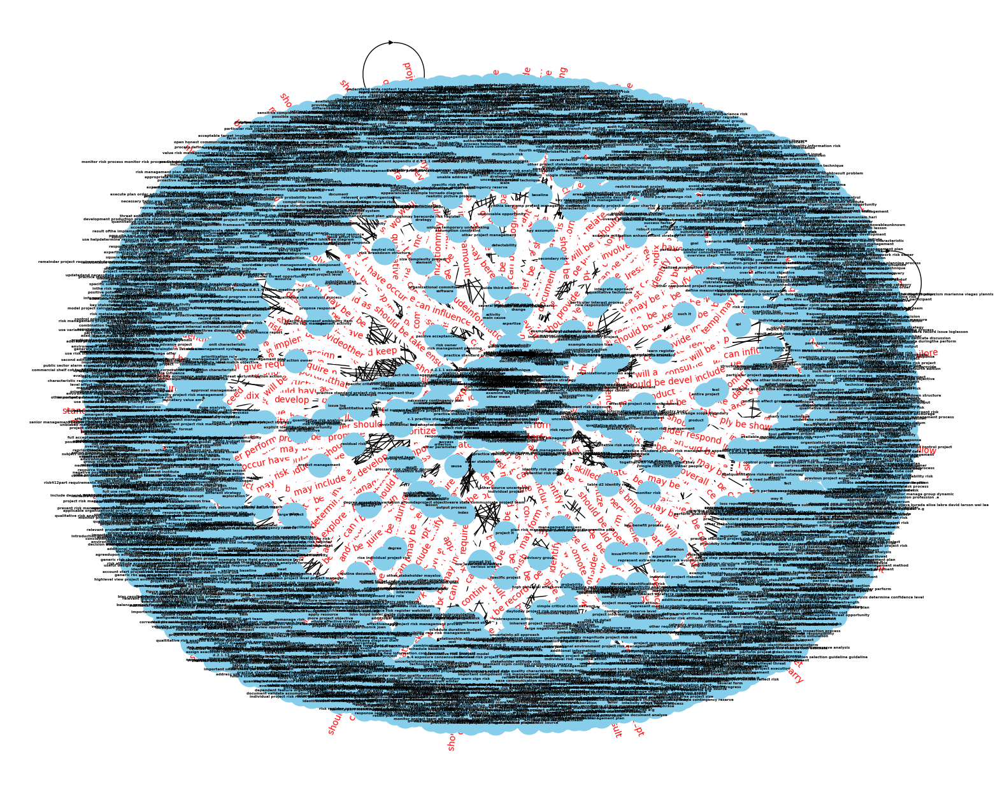

In [30]:
import dgl
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt

# Assuming you already have a DataFrame named 'df' with 'Subject', 'Object', and 'Relation' columns

# Create a DGL graph from the "Subject," "Object," and "Relation" columns
G = dgl.DGLGraph()

# Extract the unique nodes from "Subject" and "Object" columns
nodes = pd.concat([df['Subject'], df['Object']]).unique()
node_dict = {node: i for i, node in enumerate(nodes)}  # Create a mapping from node name to index

# Add nodes to the graph
G.add_nodes(len(nodes))

# Extract the edges and the corresponding relation
src = df['Subject'].apply(lambda x: node_dict[x]).tolist()
dst = df['Object'].apply(lambda x: node_dict[x]).tolist()
relations = df['Relation'].tolist()

G.add_edges(src, dst)

# Visualization (optional)
fig, ax = plt.subplots(figsize=(20, 16))  # Create a new figure and axis

# Create a NetworkX graph for visualization
nx_G = G.to_networkx()
pos_layout = nx.spring_layout(nx_G)

# Map node indices to node names
node_labels = {i: node for node, i in node_dict.items()}

# Draw nodes with labels using the node names
nx.draw(nx_G, pos_layout, labels=node_labels, font_weight='bold', node_size=700, node_color='skyblue', font_size=4, ax=ax)  # Pass the 'ax' parameter

# Draw edge labels from the "Relation" column
edge_labels = {(src[i], dst[i]): relations[i] for i in range(len(src))}
nx.draw_networkx_edge_labels(nx_G, pos_layout, edge_labels=edge_labels, font_color='red', ax=ax)  # Pass the 'ax' parameter

# Show the plot
plt.show()


# Graph + TransE

C:\Users\eyawo\anaconda3\lib\site-packages\dgl\heterograph.py:92: DGLWarning: Recommend creating graphs by `dgl.graph(data)` instead of `dgl.DGLGraph(data)`.
  dgl_warning(


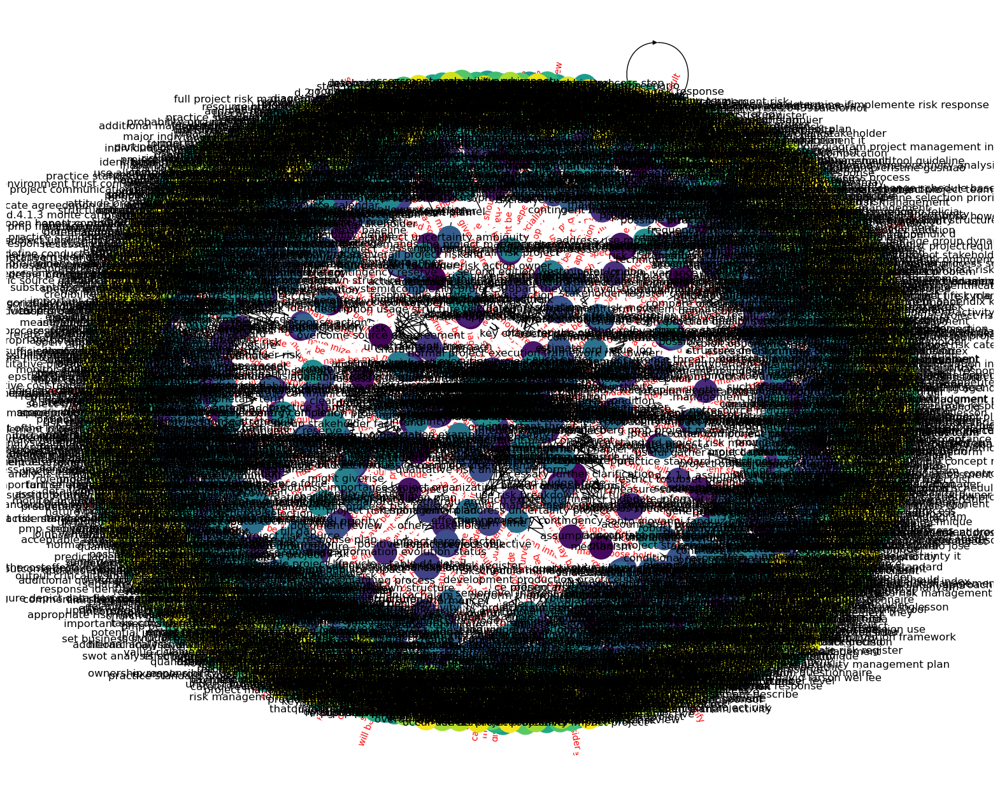

<Figure size 2000x1600 with 0 Axes>

In [100]:
import pandas as pd
import dgl
import torch
import numpy as np
import matplotlib.pyplot as plt
import networkx as nx

# Define a KG
kg = df.rename(columns={'Subject': 'head', 'Relation': 'relation', 'Object': 'tail'})

# Create a set of unique entities and relations
entities = set(kg['head'].tolist() + kg['tail'].tolist())
relations = set(kg['relation'].tolist())

# Create mappings from entities and relations to numerical IDs
entity_to_id = {entity: idx for idx, entity in enumerate(entities)}
relation_to_id = {relation: idx for idx, relation in enumerate(relations)}
nodes = pd.concat([df['Subject'], df['Object']]).unique()
node_dict = {node: i for i, node in enumerate(nodes)}  # Create a mapping from node name to index

# Create a DGL graph
G = dgl.DGLGraph()
G.add_nodes(len(entities))

src = df['Subject'].apply(lambda x: node_dict[x]).tolist()
dst = df['Object'].apply(lambda x: node_dict[x]).tolist()
relations = df['Relation'].tolist()
edge_labels = {(src[i], dst[i]): relations[i] for i in range(len(src))}

G.add_edges(src, dst)

# Generate TransE embeddings for entities (you can use your own training logic)
entity_embeddings = torch.nn.Embedding(len(entities), 50)  # Adjust the embedding dimension as needed

# Visualization (optional)
fig, ax = plt.subplots(figsize=(20, 16))

# Create a NetworkX graph for visualization
nx_G = G.to_networkx()
pos_layout = nx.spring_layout(nx_G)
plt.figure(figsize=(20, 16))

# Draw nodes with labels and embeddings
node_labels = {i: entity for entity, i in entity_to_id.items()}
node_colors = np.arange(len(entity_to_id))
nx.draw(nx_G, pos_layout, labels=node_labels, node_size=700, node_color=node_colors, cmap=plt.get_cmap('viridis'), ax=ax)
# Draw edge labels from the "Relation" column

nx.draw_networkx_edge_labels(nx_G, pos_layout, edge_labels=edge_labels, font_color='red', ax=ax)  # Pass the 'ax' parameter
# Show the plot
plt.show()

# n graphs (concepts + relations)

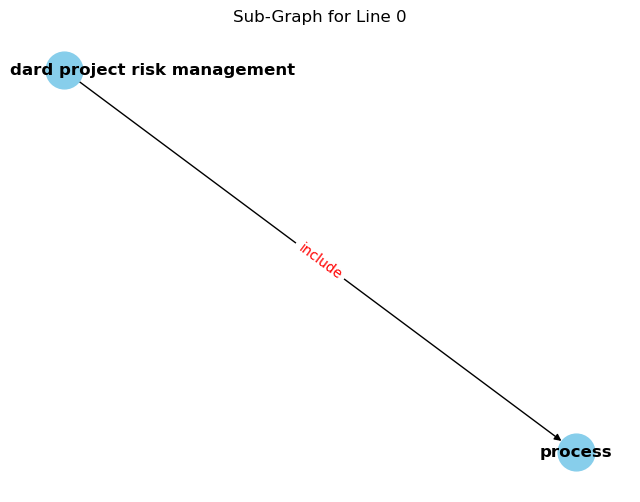

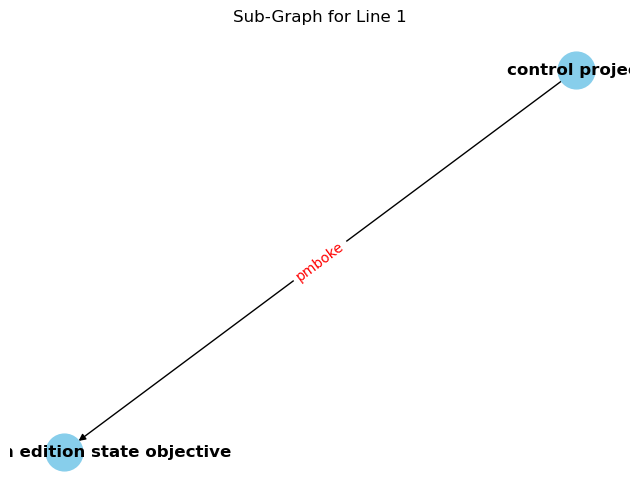

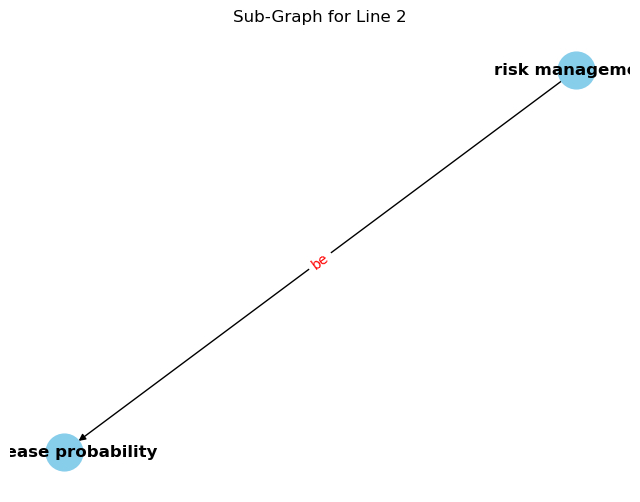

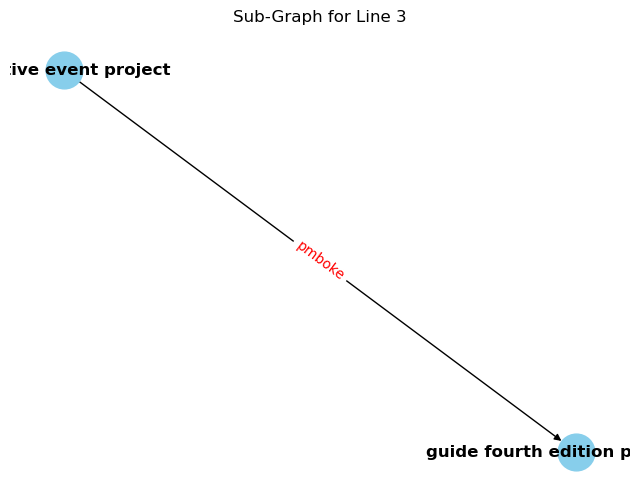

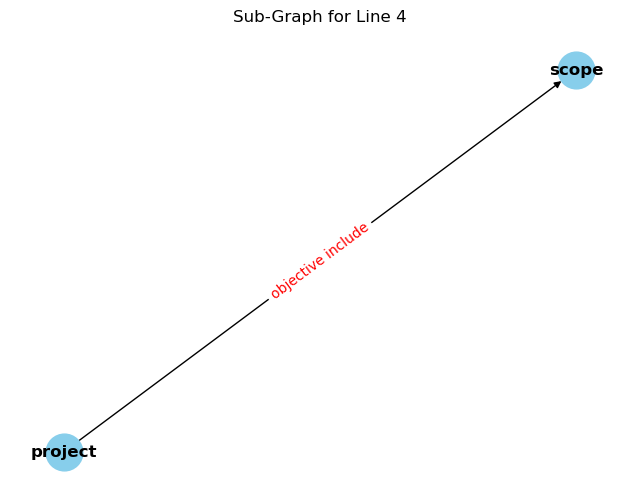

...

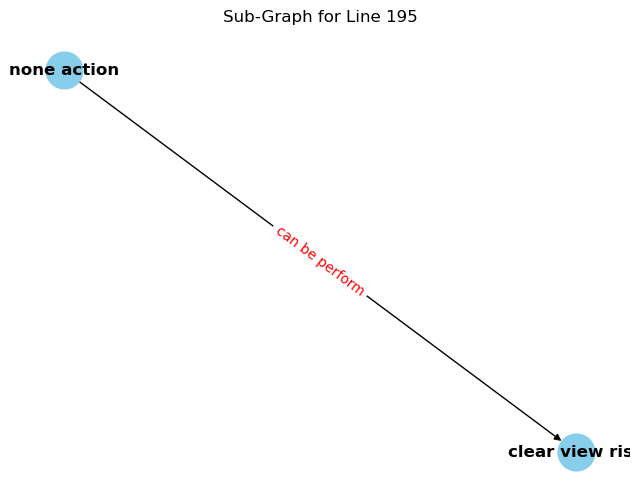

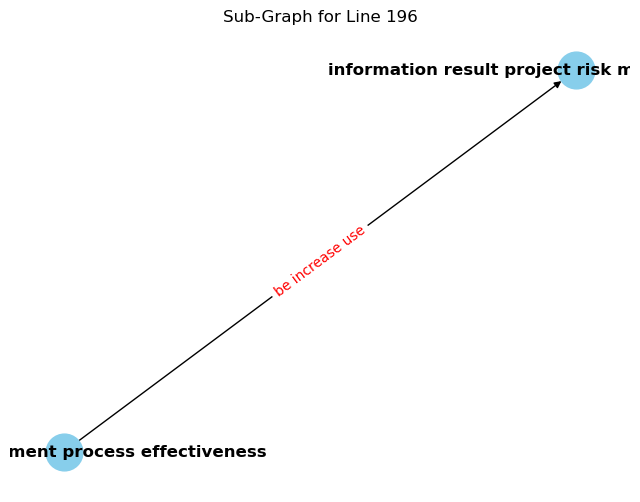

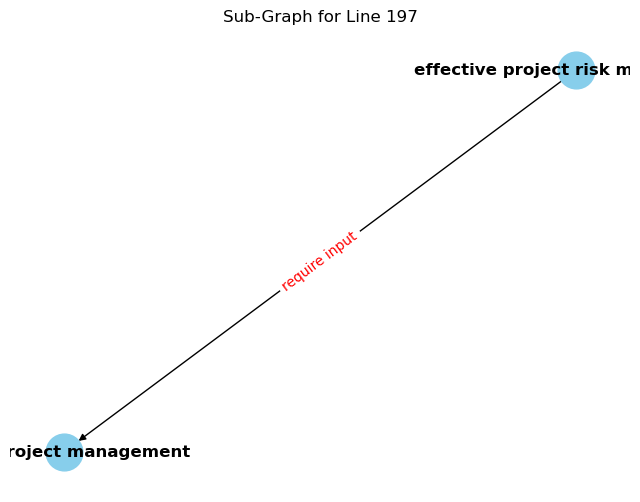

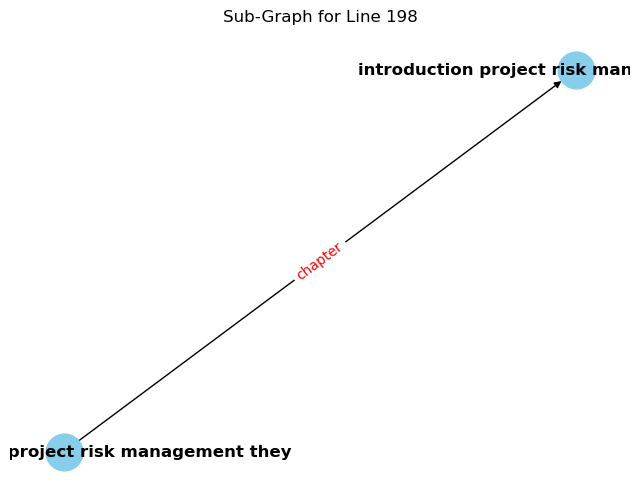

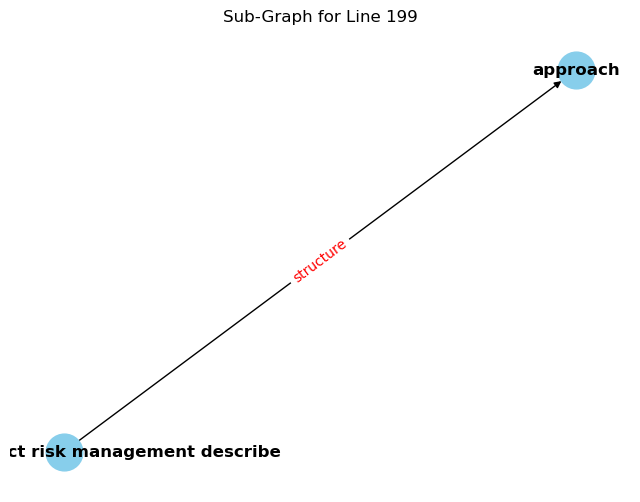

In [48]:
import dgl
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt

# Assuming you already have a DataFrame named 'df' with 'Subject', 'Object', and 'Relation' columns

# Create a DGL graph for each line in the DataFrame and visualize them
for index, row in df.iterrows():
    G = dgl.DGLGraph()
    
    # Extract the unique nodes from the "Subject" and "Object" columns for this line
    nodes = pd.Series([row['Subject'], row['Object']]).unique()
    node_dict = {node: i for i, node in enumerate(nodes)}  # Create a mapping from node name to index
    
    # Add nodes to the graph
    G.add_nodes(len(nodes))
    
    # Extract the edges and the corresponding relation for this line
    src = [node_dict[row['Subject']]]
    dst = [node_dict[row['Object']]]
    relations = [row['Relation']]
    
    G.add_edges(src, dst)
    
    # Visualization (optional)
    fig, ax = plt.subplots(figsize=(8, 6))  # Create a new figure and axis for each sub-graph
    
    # Create a NetworkX graph for visualization
    nx_G = G.to_networkx()
    pos_layout = nx.spring_layout(nx_G)
    
    # Map node indices to node names
    node_labels = {i: node for node, i in node_dict.items()}
    
    # Draw nodes with labels using the node names
    nx.draw(nx_G, pos_layout, labels=node_labels, font_weight='bold', node_size=700, node_color='skyblue', font_size=12, ax=ax)  # Pass the 'ax' parameter
    
    # Draw edge labels from the "Relation" column
    edge_labels = {(src[0], dst[0]): relations[0]}
    nx.draw_networkx_edge_labels(nx_G, pos_layout, edge_labels=edge_labels, font_color='red', ax=ax)  # Pass the 'ax' parameter
    
    # Show the plot for this sub-graph
    plt.title(f'Sub-Graph for Line {index}')
    plt.show()


# word embeding 

In [49]:
##FastText
## extended from Word2Vec
import pandas as pd
from gensim.models import FastText
import numpy as np

# Load your DataFrame and the specific column you want to process
 # Replace with your data file
text_column = df["Definition"]  # Replace with your column name

# Tokenize the text and preprocess it (you can customize this as needed)
sentences = text_column.str.split()  # Split text into words

# Create and train a FastText model
model = FastText(sentences, vector_size=100, window=5, min_count=1, sg=1)

# Initialize an empty list to store the word vectors for each document
document_vectors = []

# Get word embeddings for each document
for sentence in sentences:
    doc_vector = [model.wv[word] for word in sentence if word in model.wv]
    if doc_vector:
        # Average the word vectors to get the document vector
        avg_doc_vector = np.mean(doc_vector, axis=0)
        document_vectors.append(avg_doc_vector)

# Convert the list of document vectors to a NumPy array for matrix representation
document_matrix = np.array(document_vectors)

# Now, document_matrix contains the word embeddings for each document in the "Definition" column.
document_matrix

array([[ 0.36709526, -0.6356615 ,  1.0035824 , ..., -0.13695261,
         0.27227327, -0.5941904 ],
       [ 0.36709526, -0.6356615 ,  1.0035824 , ..., -0.13695261,
         0.27227327, -0.5941904 ],
       [ 0.36709526, -0.6356615 ,  1.0035824 , ..., -0.13695261,
         0.27227327, -0.5941904 ],
       ...,
       [ 0.30706418, -0.5506171 ,  0.75177413, ..., -0.1578214 ,
         0.2803812 , -0.5343769 ],
       [ 0.30706418, -0.5506171 ,  0.75177413, ..., -0.1578214 ,
         0.2803812 , -0.5343769 ],
       [ 0.23144722, -0.32866007,  0.23307751, ..., -0.14225303,
         0.30420995, -0.3939121 ]], dtype=float32)

In [81]:
pip install gensim

Note: you may need to restart the kernel to use updated packages.


In [50]:

import numpy as np
from gensim.models import Word2Vec
###Word2Vec model
synonyms_column = df["synonyms"]

# Create sentences from the tokenized synonyms
sentences = [synonyms.split() if isinstance(synonyms, str) else [] for synonyms in synonyms_column]

# Train a Word2Vec model
model = Word2Vec(sentences, vector_size=100, window=5, min_count=1, sg=0)

# Access word vectors
word_vectors = model.wv

# Create a matrix of word vectors for all synonyms
synonym_matrix = np.array([word_vectors[synonyms] for synonyms in sentences for synonyms in synonyms if synonyms in word_vectors])

# Now, synonym_matrix contains the word embeddings for all synonyms in the "synonyms" column as a NumPy array.
synonym_matrix


array([[ 0.00142808,  0.292536  ,  0.00918799, ...,  0.15418369,
         0.06525576,  0.28242224],
       [ 0.0222044 ,  0.34903955, -0.02827954, ...,  0.18910949,
         0.10348529,  0.26751176],
       [-0.08515286,  0.3048002 ,  0.05509029, ...,  0.14087115,
         0.05333369,  0.23025157],
       ...,
       [-0.09646577,  0.2703281 ,  0.06286912, ...,  0.1289346 ,
         0.04656633,  0.21562998],
       [-0.03969212,  0.25039235,  0.02565207, ...,  0.11072383,
         0.07328782,  0.24520175],
       [-0.09153969,  0.24202058,  0.04701185, ...,  0.1323028 ,
         0.05393747,  0.24086747]], dtype=float32)

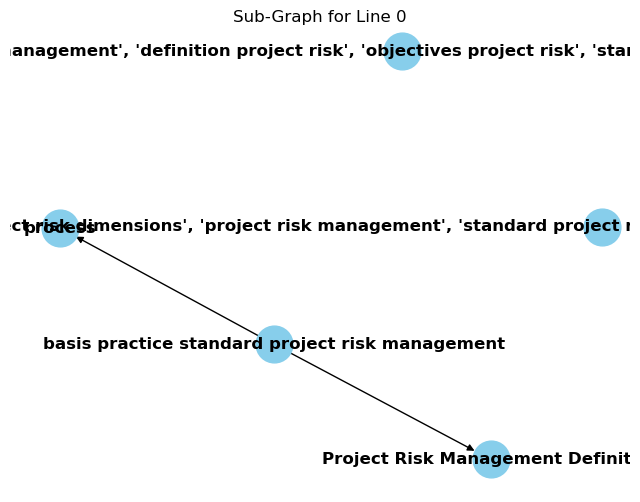

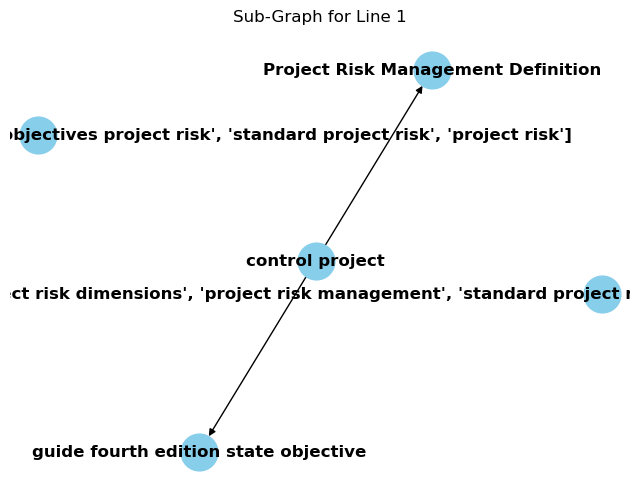

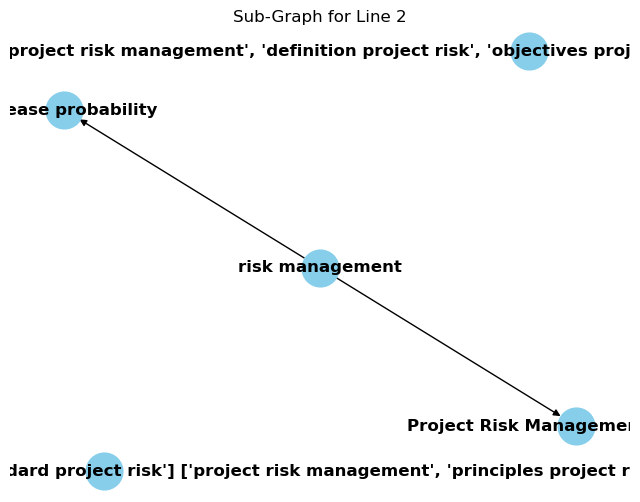

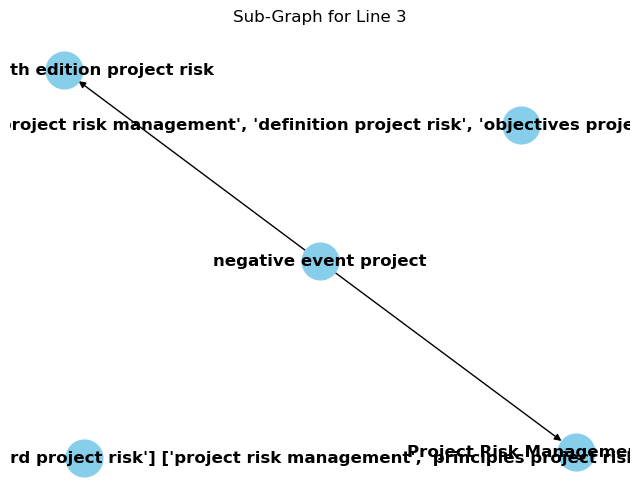

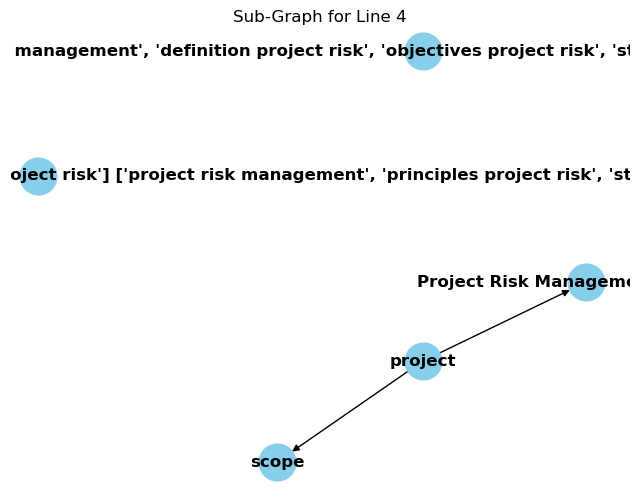

...

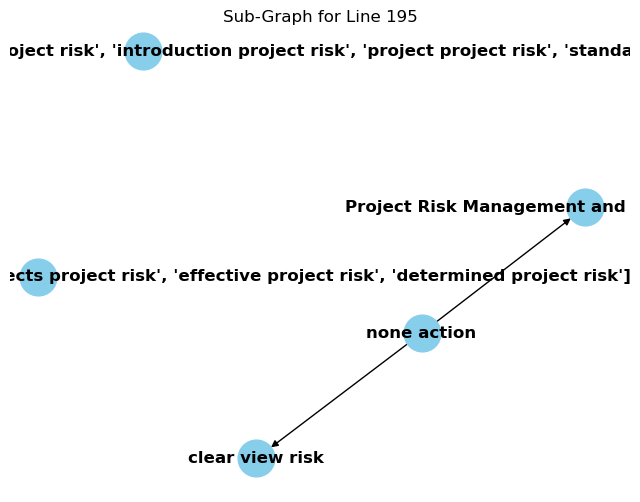

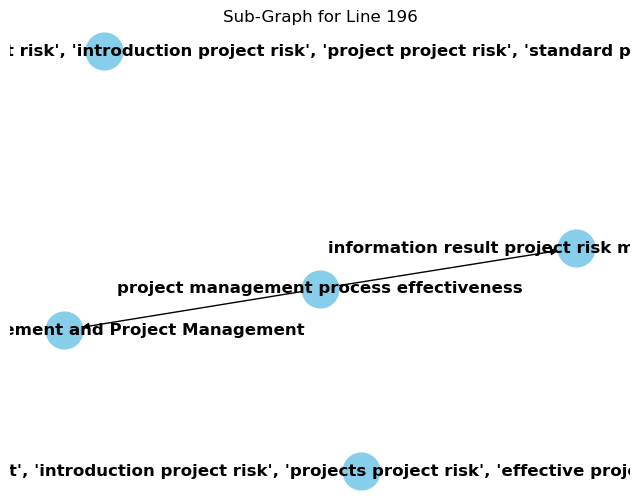

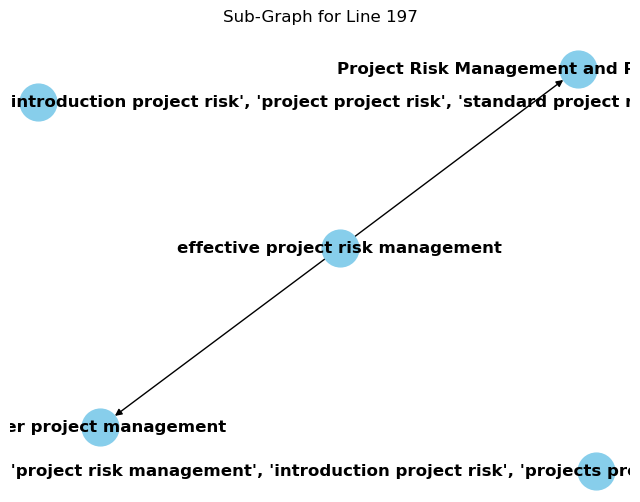

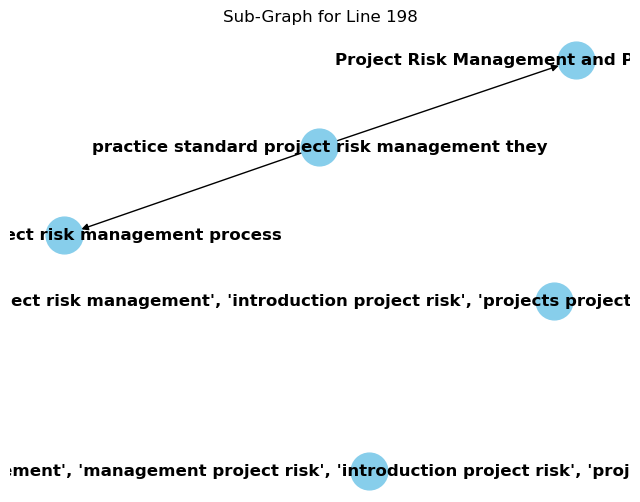

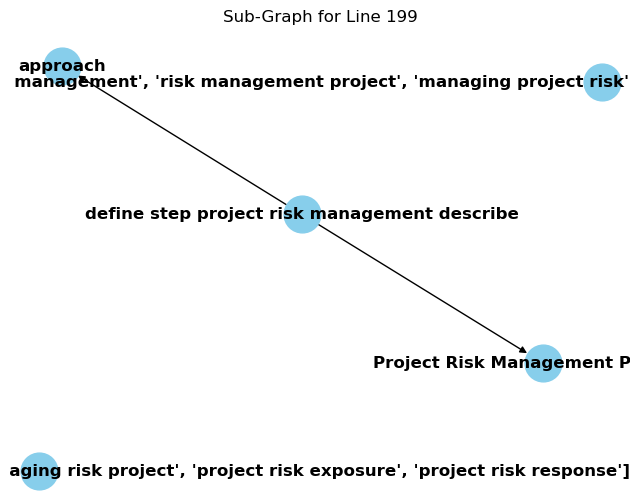

In [52]:
import dgl
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt

# Assuming you already have a DataFrame named 'df' with 'Subject', 'Object', 'Relation', 'Title', 'Definition', 'kw_bert', and 'Synonyms' columns

# Create a DGL graph for each line in the DataFrame and visualize them
for index, row in df.iterrows():
    # Create a DGL graph
    G = dgl.DGLGraph()

    # Extract unique nodes from all relevant columns
    nodes = pd.Series([row['Subject'], row['Object'], row['Title'], row['kw_bert'], row['synonyms']]).unique()
    node_dict = {node: i for i, node in enumerate(nodes)}  # Create a mapping from node name to index

    # Add nodes to the graph
    G.add_nodes(len(nodes))

    # Extract the edges for the subject-object relationship
    src = [node_dict[row['Subject']]
           for _ in row['Object'].split(',')]
    dst = [node_dict[row['Object']]
           for _ in row['Object'].split(',')]
    relations = [row['Relation']] * len(src)

    G.add_edges(src, dst)

    # Extract edges for the relationships between other features and nodes
    for feature_column in ['Title', 'kw_bert', 'synonyms']:
        if not pd.isna(row[feature_column]):
            src = [node_dict[row['Subject']] for _ in row[feature_column].split(',')]

            # Filter out nodes that don't exist in node_dict
            dst = [node_dict[feature] for feature in row[feature_column].split(',') if feature in node_dict]

            G.add_edges(src, dst)

    # Visualization (optional)
    fig, ax = plt.subplots(figsize=(8, 6))  # Create a new figure and axis for each sub-graph

    # Create a NetworkX graph for visualization
    nx_G = G.to_networkx()
    pos_layout = nx.spring_layout(nx_G)

    # Map node indices to node names
    node_labels = {i: node for node, i in node_dict.items()}

    # Draw nodes with labels using the node names
    nx.draw(nx_G, pos_layout, labels=node_labels, font_weight='bold', node_size=700, node_color='skyblue', font_size=12, ax=ax)  # Pass the 'ax' parameter

    # Customize edge labels and set the color to red
    edge_labels = {(src[i], dst[i]): f"Relation: {relations[i]}" for i in range(len(dst))}
    edge_colors = {(src[i], dst[i]): 'red' for i in range(len(dst))}
    nx.draw_networkx_edge_labels(nx_G, pos_layout, edge_labels=edge_labels, font_color='red', ax=ax)  # Pass the 'ax' parameter

    # Show the plot for this sub-graph
    plt.title(f'Sub-Graph for Line {index}')
    plt.show()


KeyboardInterrupt: 

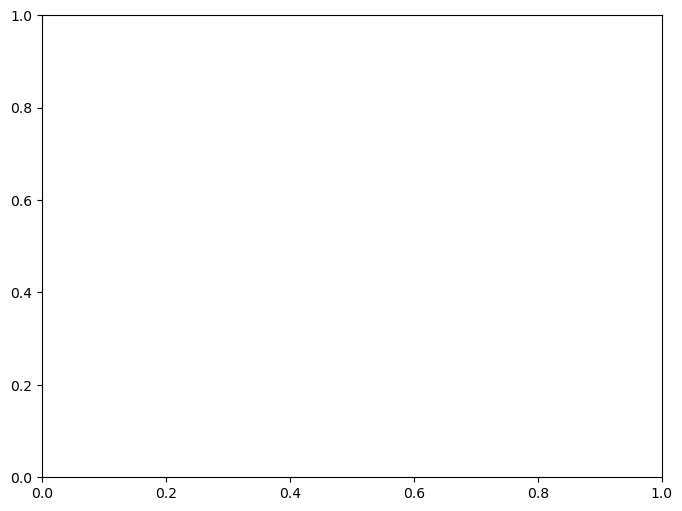

In [112]:
import dgl
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt

# Create a list to store the subgraphs
subgraphs = []

# Create a list to store all unique nodes
all_nodes = []

# Create a mapping from node name to integer ID
node_to_id = {}
next_node_id = 0

# Assuming you have already created the subgraphs and stored them in a list
for index, row in df.iterrows():
    # Create a DGL graph
    G = dgl.DGLGraph()

    # Extract unique nodes from all relevant columns
    nodes = pd.Series([row['Subject'], row['Object'], row['Title'], row['kw_bert'], row['synonyms']]).unique()

    for node in nodes:
        if node not in node_to_id:
            node_to_id[node] = next_node_id
            next_node_id += 1

    all_nodes.extend(nodes)  # Add unique nodes to the all_nodes list

    # Add nodes to the graph
    G.add_nodes(len(nodes))

    # Extract the edges for the subject-object relationship
    src = [node_to_id[row['Subject']]
           for _ in row['Object'].split(',')]
    dst = [node_to_id[obj] for obj in row['Object'].split(',')]
    relations = [row['Relation']] * len(src)

    G.add_edges(src, dst)

    # Extract edges for the relationships between other features and nodes
    for feature_column in ['Title', 'kw_bert', 'synonyms']:
        if not pd.isna(row[feature_column]):
            src = [node_to_id[row['Subject']] for _ in row[feature_column].split(',')]

            # Filter out nodes that don't exist in node_to_id
            dst = [node_to_id[feature] for feature in row[feature_column].split(',') if feature in node_to_id]

            G.add_edges(src, dst)

    subgraphs.append(G)

# Create a big graph by merging all the subgraphs
big_graph = dgl.batch(subgraphs)

# Visualization (optional) for the big graph
fig, ax = plt.subplots(figsize=(8, 6))
nx_G = big_graph.to_networkx()

# Use all_nodes as labels
node_labels = {node_to_id[node]: node for node in all_nodes}

pos_layout = nx.spring_layout(nx_G)
nx.draw(nx_G, pos_layout, labels=node_labels, font_weight='bold', node_size=700, node_color='skyblue', font_size=12, ax=ax)

# Customize edge labels and set the color to red
edge_labels = {(src[i], dst[i]): f"Relation: {relations[i]}" for i in range(len(dst))}
edge_colors = {(src[i], dst[i]): 'red' for i in range(len(dst))}
nx.draw_networkx_edge_labels(nx_G, pos_layout, edge_labels=edge_labels, font_color='red', ax=ax)

plt.title('Big Graph')
plt.show()


# =====================